#### In this notebook we will cluster Github users with K Means and the previous application of PCA & t-SNE models

In [1]:
import pandas as pd
import numpy as np

from pymongo import MongoClient
import os
import dotenv

import matplotlib.pyplot as plt
import seaborn as sns
import plotly.graph_objects as go
import plotly.offline as py

%matplotlib inline
from mpl_toolkits.mplot3d import Axes3D

import warnings

/home/diego/anaconda3/lib/python3.7/site-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


### Mongo connection, extract and normalize

In [2]:
dotenv.load_dotenv()
MGURL = os.getenv("MGURL")
myclient = MongoClient(f"{MGURL}")
db = myclient.github

In [3]:
git = list(db.profiles.find({},{"_id":0, "company":0, "location":0, "email":0, "hireable":0}))

In [4]:
df = pd.json_normalize(git, "repos", ["name","repos_number","followers","created","updated"])

### Clean and prepare dataframe

In [5]:
print(df.shape)
df.head()

(1037132, 10)


,repo_name,forked,stars,language,forks,name,repos_number,followers,created,updated
0,AwesomeNER,False,6,Jupyter Notebook,2,Tarun Sudhams,23,33,2016-05-27T06:16:14Z,2020-05-05T07:34:00Z
1,coding-interview-university,True,2,None,1,Tarun Sudhams,23,33,2016-05-27T06:16:14Z,2020-05-05T07:34:00Z
2,COMP2396-assignments,False,0,Java,0,Tarun Sudhams,23,33,2016-05-27T06:16:14Z,2020-05-05T07:34:00Z
3,Computer-and-Communication-Networks,False,0,Python,1,Tarun Sudhams,23,33,2016-05-27T06:16:14Z,2020-05-05T07:34:00Z
4,Costa-Rican-Household-Poverty-Level-Prediction,False,0,HTML,4,Tarun Sudhams,23,33,2016-05-27T06:16:14Z,2020-05-05T07:34:00Z


In [6]:
df.created = df.created.str.replace(r"\b(?:(?!\d{4}-\d{2}).*)","")
df.updated = df.updated.str.replace(r"\b(?:(?!\d{4}-\d{2}).*)","")
df.drop(columns={"repo_name", "language"}, inplace=True)

In [7]:
df.isnull().sum()

forked              0
stars               0
forks               0
name            33898
repos_number        0
followers           0
created             0
updated             0
dtype: int64

In [8]:
df["years"] = df.updated.astype(int)-df.created.astype(int)
df.drop(columns={"created","updated"}, axis=1, inplace=True)
df.dropna(how="any", inplace=True)

In [9]:
print(df.shape)
df.isnull().sum()

(1003234, 7)


forked          0
stars           0
forks           0
name            0
repos_number    0
followers       0
years           0
dtype: int64

In [10]:
num = df.groupby(["name", "repos_number", "followers", "years"]).agg({"stars":"sum", "forks":"sum"}).reset_index()

In [11]:
num[num.name=="Tarun Sudhams"]

,name,repos_number,followers,years,stars,forks
33492,Tarun Sudhams,23,33,4,49,38


In [12]:
cat = df.groupby(["name","forked"]).size().unstack(fill_value=0).reset_index().rename(columns={"index":"name",False:"user_repo",True:"forked_repo"})

In [13]:
cat[cat.name=="Tarun Sudhams"]

forked,name,user_repo,forked_repo
32038,Tarun Sudhams,19,4


In [14]:
df = pd.merge(num, cat, on="name")

In [15]:
df[df.name=="Tarun Sudhams"]

,name,repos_number,followers,years,stars,forks,user_repo,forked_repo
33492,Tarun Sudhams,23,33,4,49,38,19,4


In [16]:
df.drop_duplicates(subset={"name"}, inplace=True)

### Descriptive Analysis

In [17]:
print(df.shape)
df.head()

(39730, 8)


,name,repos_number,followers,years,stars,forks,user_repo,forked_repo
0,Aníbal Catheringer,2,1,6,0,0,2,0
1,Cohen,18,2,3,0,2,18,0
2,Enrico Antonello,43,14,7,7,2,28,15
3,Jakub Smadiš,16,1,3,0,0,3,13
4,Marián Černý,16,3,8,22,6,3,13


In [18]:
df.describe()

,repos_number,followers,years,stars,forks,user_repo,forked_repo
count,39730.000000,39730.000000,39730.000000,39730.000000,39730.000000,39730.000000,39730.000000
mean,24.255525,24.255298,6.184797,77.669846,21.080191,12.482884,12.768412
std,106.191221,345.282214,2.895754,1015.294577,296.282536,50.270065,91.373219
min,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,5.000000,3.000000,4.000000,0.000000,0.000000,3.000000,1.000000
50%,12.000000,6.000000,6.000000,3.000000,1.000000,7.000000,4.000000
75%,27.000000,13.000000,8.000000,15.000000,6.000000,15.000000,11.000000
max,14637.000000,57545.000000,12.000000,123102.000000,34154.000000,9349.000000,14433.000000


#### As we see there are high max values compared to the means and medians, so we will show the users that can be considered outliers later below

In [19]:
X = df.drop(columns={"name"})

In [20]:
outliers = df[(X>1000).any(1)]
print(outliers.shape)
outliers.head()

(499, 8)


,name,repos_number,followers,years,stars,forks,user_repo,forked_repo
361,Adam Coddington,185,174,10,1975,434,120,65
421,Adam Mckaig,141,358,12,2029,461,82,59
467,Adam Zapletal,31,72,11,1987,376,10,21
1080,Alberto Paro,122,129,12,1108,401,30,92
1083,Alberto Pettarin,49,72,7,1071,271,29,20


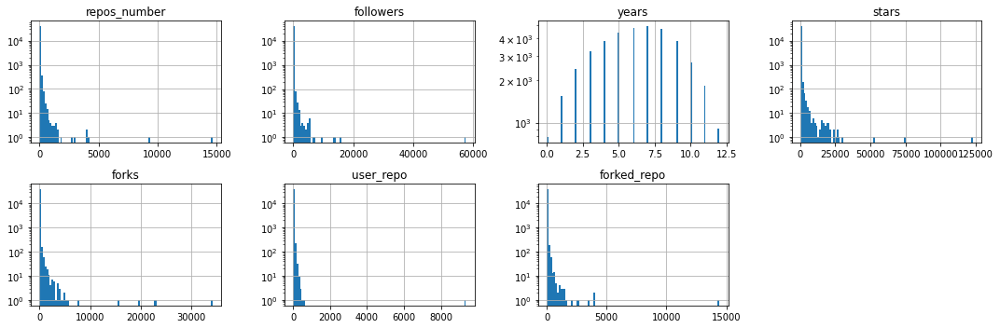

In [21]:
#we can see in all variables except for years and stars that the frequency of 0 es huge
figure = plt.figure(figsize=(15,5))

for n, c in enumerate(X.columns):
  ax = figure.add_subplot(2,4,n+1)
  ax.set_title(c)
  ax.set_yscale("log") #the log scale help us to have a better idea of our data when the distribution is not fair
  X[c].hist(ax=ax, bins=100)

figure.tight_layout() #this feature separate the graphs correctly
plt.show()

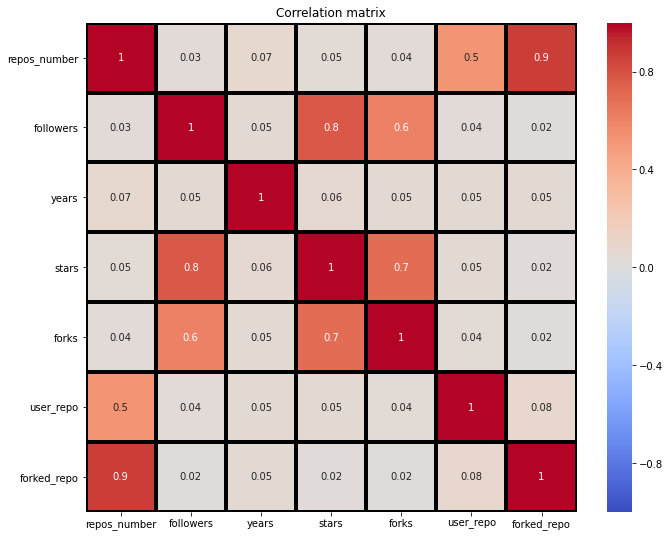

In [22]:
plt.figure(figsize=(11,9))

sns.heatmap(X.corr(), annot = True, fmt='.1g', vmin=-1, vmax=1, center= 0, cmap= 'coolwarm' , linewidths=3, linecolor='black')

plt.title('Correlation matrix')

plt.show()

#### There is a big positive linear relation between followers, stars and forks. However none of the repo columns  neither yeas are related with the 3 previous vars. Therefore we will take these 3 vars as the main characteristics to determine the seniority of users

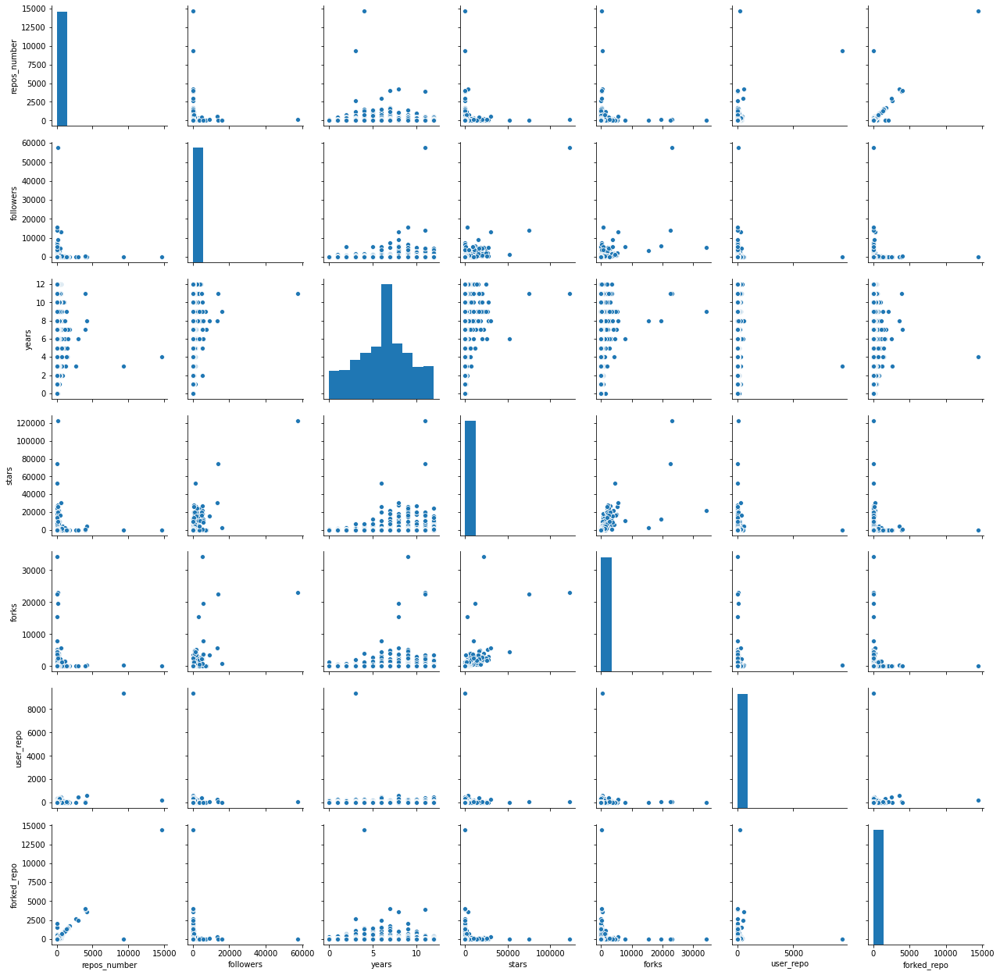

In [23]:
sns.pairplot(X)
plt.show()

#### Above we can see some variables with really huge outliers that could affect our cluster model. Therefore we will delete them before appyling the dimensional reduction

In [24]:
df[(X>10000).any(1)]

,name,repos_number,followers,years,stars,forks,user_repo,forked_repo
1822,Alexander Lukyanchikov,22,762,7,17038,4981,6,16
2195,Allen Downey,105,5713,8,12031,19572,78,27
2518,Andrea Cardaci,32,420,8,11256,1029,27,5
2649,Andrea Mazzini,126,1183,9,19122,2196,31,95
3087,Andrew Carl,14637,27,4,48,39,204,14433
3242,Andrey Sitnik,60,4506,12,24147,1974,58,2
3878,Artur Arseniev,45,664,5,12172,2796,33,12
4938,Brad Larson,23,1928,9,26037,5292,17,6
5048,Brendan Gregg,42,4461,8,18460,2712,28,14
5137,Brian Caffo,57,3250,8,2481,15378,37,20


In [25]:
df.drop(df[(X>10000).any(1)].index, inplace=True)

In [26]:
print(df.shape)
df.describe()

(39686, 8)


,repos_number,followers,years,stars,forks,user_repo,forked_repo
count,39686.000000,39686.000000,39686.000000,39686.000000,39686.000000,39686.000000,39686.000000
mean,23.797384,19.327017,6.181878,53.918636,15.689790,12.424558,12.369702
std,76.724573,102.115694,2.895288,320.929531,88.935472,50.205722,55.798046
min,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,5.000000,3.000000,4.000000,0.000000,0.000000,3.000000,1.000000
50%,12.000000,6.000000,6.000000,3.000000,1.000000,7.000000,4.000000
75%,26.000000,13.000000,8.000000,14.000000,6.000000,15.000000,11.000000
max,9349.000000,7284.000000,12.000000,9979.000000,4111.000000,9349.000000,3966.000000


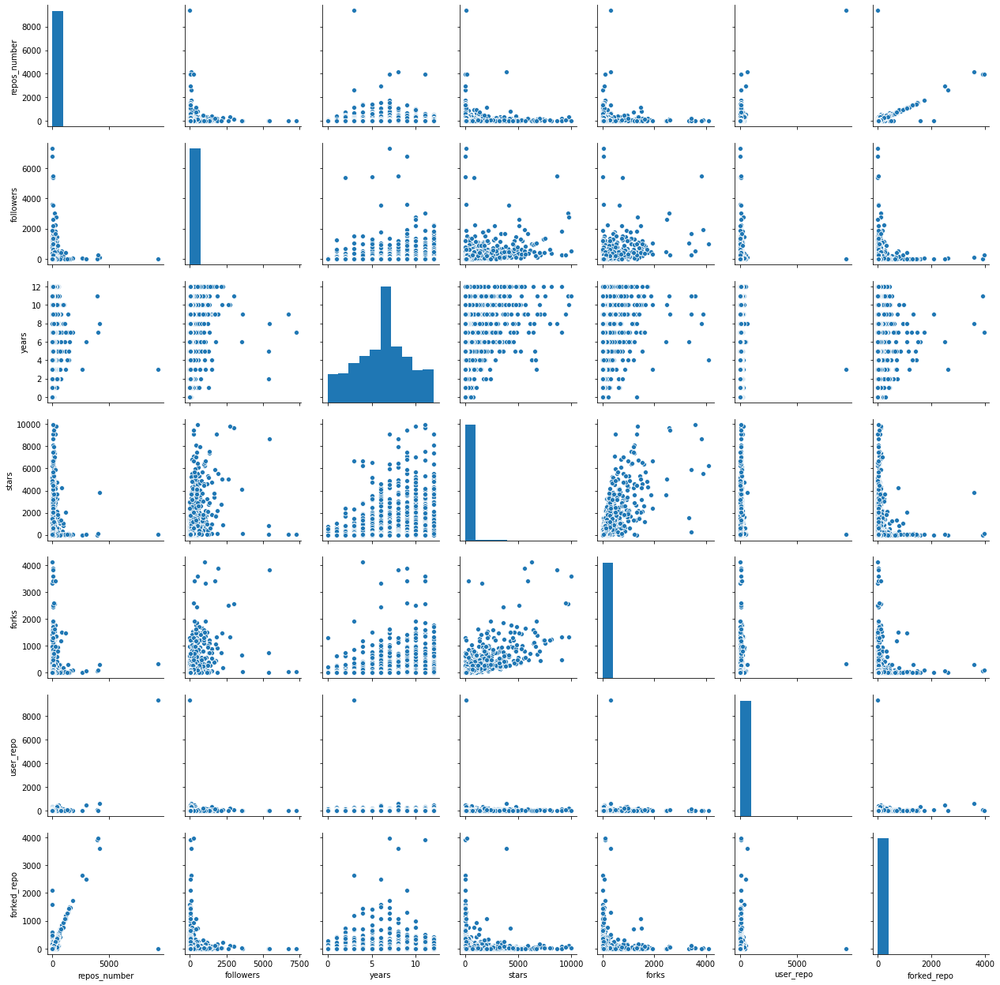

In [27]:
sns.pairplot(df)
plt.show()

#### Now the outliers have been reduced, however we still can see some of them in repos_number, followers and forks, lets delete them too

In [28]:
df[(df.repos_number>2500)|(df.followers>2500)|(df.forks>2000)]

,name,repos_number,followers,years,stars,forks,user_repo,forked_repo
2401,Anders Hejlsberg,1,7284,7,77,31,1,0
5082,Bret Fisher,61,1924,9,5568,3885,33,28
5741,Cat,2645,77,3,2,1,26,2619
6201,Chris Lattner,1,5418,5,37,3,0,1
7777,Daniel Feldroy,177,3004,11,9701,2579,83,94
8462,David J. Malan,5,6757,9,27,31,2,3
9274,Dimitris-Ilias Gkanatsios,46,460,6,3592,2450,37,9
9282,Dinesh Kr. Choudhary,4196,109,8,3854,314,588,3608
9562,Douglas C. Schmidt,14,1043,6,1570,3330,14,0
11127,Fedor Indutny,338,2765,10,9783,1340,235,103


In [29]:
df.drop(df[(df.repos_number>2500)|(df.followers>2500)|(df.forks>2000)].index, inplace=True)

In [30]:
print(df.shape)
df.describe()

(39662, 8)


,repos_number,followers,years,stars,forks,user_repo,forked_repo
count,39662.000000,39662.000000,39662.000000,39662.000000,39662.000000,39662.000000,39662.000000
mean,23.096339,17.990369,6.181080,51.805935,14.705612,12.146563,11.947254
std,45.512551,65.590676,2.895234,295.551488,69.664071,17.544044,41.051145
min,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,5.000000,3.000000,4.000000,0.000000,0.000000,3.000000,1.000000
50%,12.000000,6.000000,6.000000,3.000000,1.000000,7.000000,4.000000
75%,26.000000,13.000000,8.000000,14.000000,6.000000,15.000000,11.000000
max,1762.000000,2241.000000,12.000000,9101.000000,1934.000000,459.000000,2092.000000


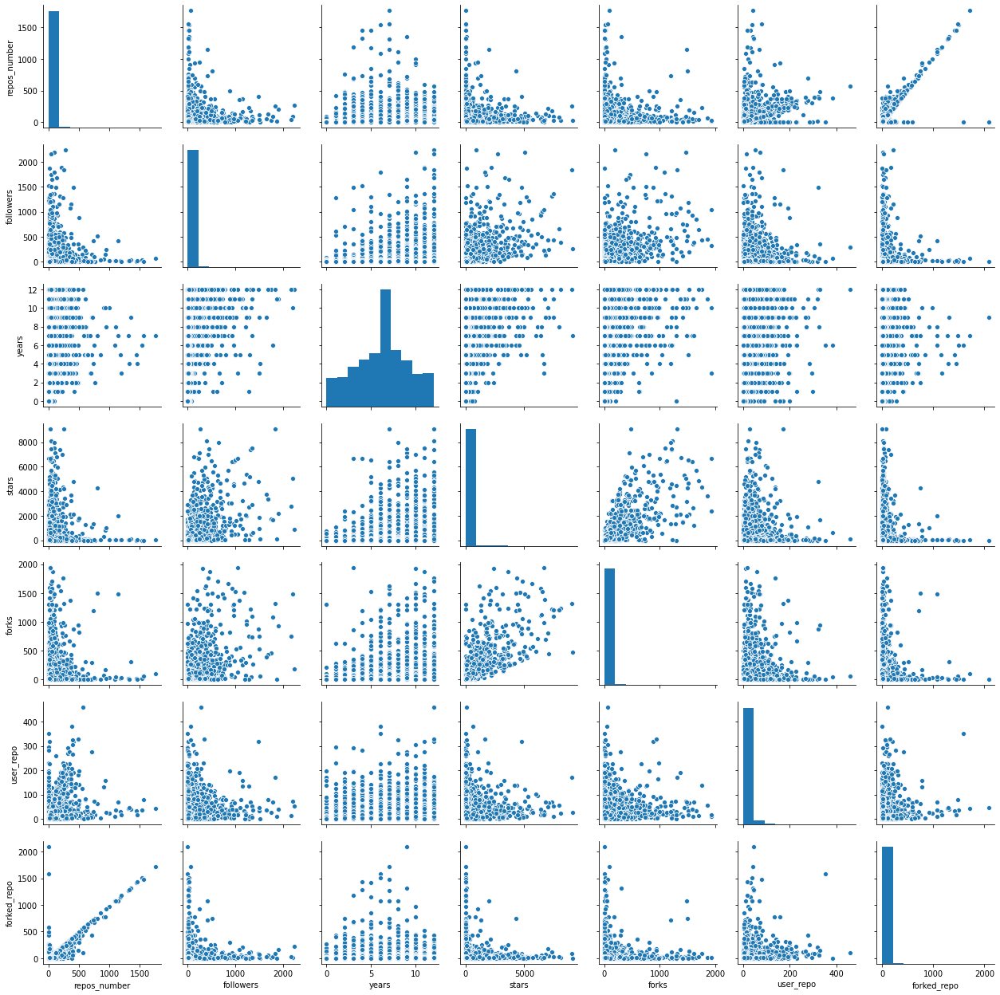

In [31]:
sns.pairplot(df)
plt.show()

#### After cleaning the outliers 2 times we now see a better distribution, however new outliers in some of the relations have appeared:
    - repos_number and years: we see a big dispersion from 750 repos on
    - followers with forks or stars: around 1k followers the dot spreadness is clear
    - stars with forks or followers: around 5k the dots start to spread
    
#### Also looking the descriptive table we still see super huge std, so we will delete the mentioned outliers too

In [32]:
df[(df.repos_number>=750)|(df.followers>=1000)|(df.stars>=5000)]

,name,repos_number,followers,years,stars,forks,user_repo,forked_repo
1636,Alex Gray,907,54,10,322,77,132,775
1707,Alex Payne,49,1052,12,503,131,22,27
2396,AndOr,1178,18,5,21,19,30,1148
2751,Andrea Verlicchi,67,137,9,5532,549,41,26
3121,Andrew Godwin,34,1754,12,1745,462,27,7
...,...,...,...,...,...,...,...,...
37613,Zhihua Liang,1107,23,8,50,48,37,1070
37850,anukat2015,1447,5,5,6,20,32,1415
38312,emtee40,1456,21,4,26,8,16,1440
38838,justthefracts,1331,19,4,26,1,46,1285


In [33]:
df.drop(df[(df.repos_number>=750)|(df.followers>=1000)|(df.stars>=5000)].index, inplace=True)

In [34]:
print(df.shape)
df.describe()

(39583, 8)


,repos_number,followers,years,stars,forks,user_repo,forked_repo
count,39583.000000,39583.000000,39583.000000,39583.000000,39583.000000,39583.000000,39583.000000
mean,22.403507,16.412980,6.176364,45.468762,13.499078,12.066973,11.335119
std,36.566698,47.072531,2.893359,226.187600,59.737747,17.319501,31.680065
min,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,5.000000,3.000000,4.000000,0.000000,0.000000,3.000000,1.000000
50%,12.000000,6.000000,6.000000,3.000000,1.000000,7.000000,3.000000
75%,26.000000,13.000000,8.000000,14.000000,6.000000,15.000000,11.000000
max,742.000000,984.000000,12.000000,4999.000000,1932.000000,459.000000,2092.000000


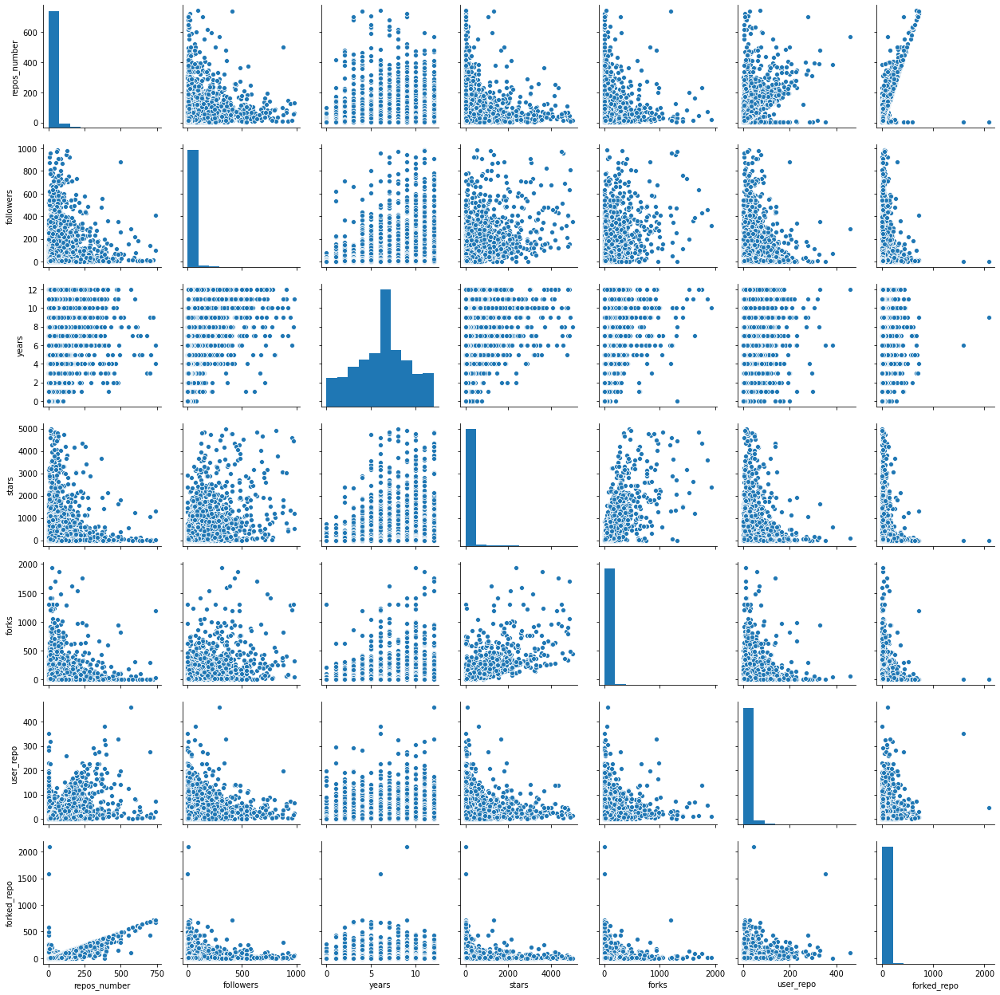

In [35]:
sns.pairplot(df)
plt.show()

#### Again, after cleaning a 3rd time we can see new outliers and the descriptive table still show broad stds, so we will clean again and see how our dataset looks like

#### Identificated outliers:
    - repos_number and followers: 500 on
    - followers and stars: 700 on
    - stars and followers: 2.2k on
    - forks with stars or followers: 800 on

In [36]:
df[(df.repos_number>=500)|(df.followers>=700)|(df.stars>=2200)|(df.forks>=800)]

,name,repos_number,followers,years,stars,forks,user_repo,forked_repo
9,#Henkate @xda.,590,37,5,38,29,31,559
239,Aaron Turon,70,726,9,154,46,17,53
754,Ahmed Sakr,679,9,3,13,5,10,669
1076,Alberto Olla,13,92,3,679,856,9,4
1207,Alessandro Arnodo,57,259,11,4049,610,30,27
...,...,...,...,...,...,...,...,...
39142,kzwkt,742,97,6,17,31,72,670
39377,midnite_runr,56,973,8,4468,1307,18,38
40472,timelyportfolio,498,878,9,1819,817,197,301
40996,zijie zhang,647,8,5,1,0,5,642


In [37]:
df.drop(df[(df.repos_number>=500)|(df.followers>=700)|(df.stars>=2200)|(df.forks>=800)].index, inplace=True)

In [38]:
print(df.shape)
df.describe()

(39412, 8)


,repos_number,followers,years,stars,forks,user_repo,forked_repo
count,39412.000000,39412.000000,39412.000000,39412.000000,39412.000000,39412.000000,39412.000000
mean,21.833223,14.962626,6.166523,35.692556,11.265249,11.933827,10.907135
std,32.891590,37.298413,2.891007,141.944171,39.461244,16.836378,28.295011
min,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,5.000000,3.000000,4.000000,0.000000,0.000000,3.000000,1.000000
50%,12.000000,6.000000,6.000000,2.000000,1.000000,7.000000,3.000000
75%,26.000000,12.000000,8.000000,14.000000,6.000000,15.000000,11.000000
max,498.000000,695.000000,12.000000,2194.000000,794.000000,382.000000,2092.000000


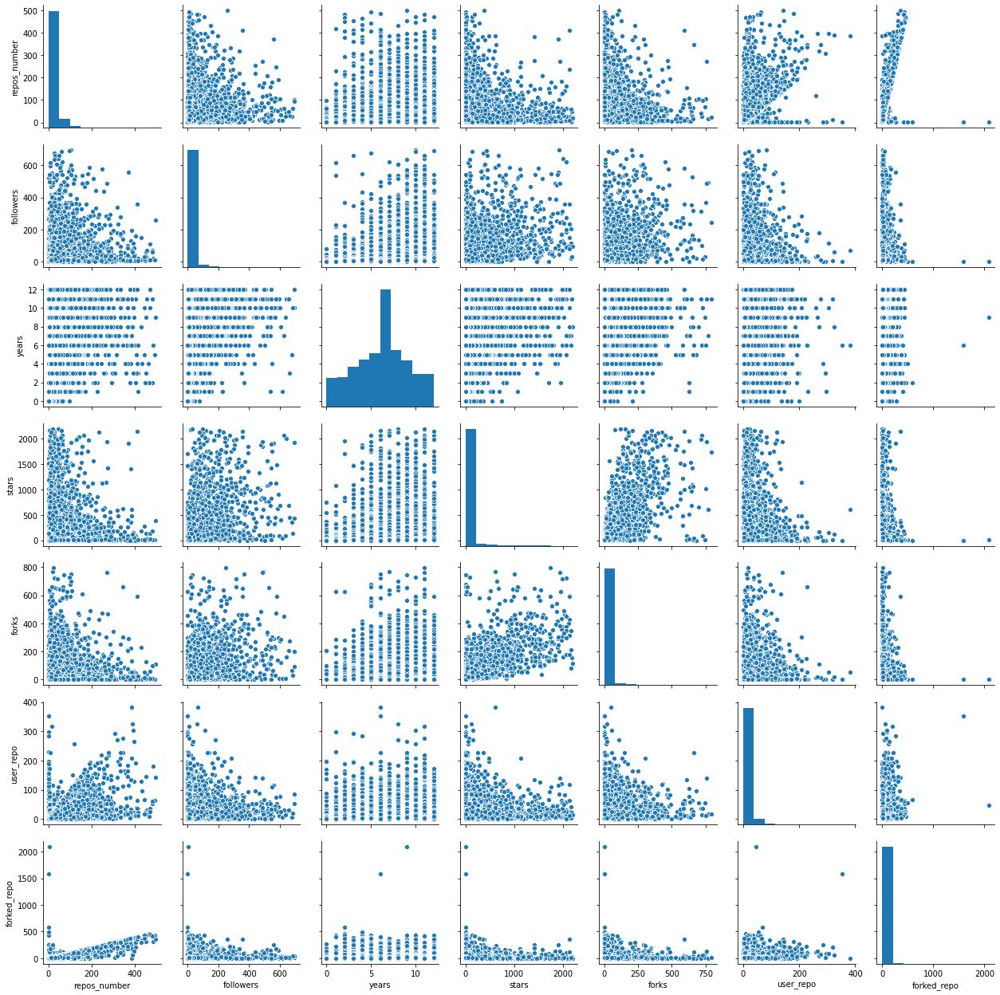

In [39]:
sns.pairplot(df)
plt.show()

#### Now the stds look better, except for stars that is still high, but we cannot identify outliers of this variable in any of its relations. However, forks has shown new outliers in the relation with stars, years and followers --> 500 on, so we are going to delete these users too

In [40]:
df[df.forks>=500]

,name,repos_number,followers,years,stars,forks,user_repo,forked_repo
2100,Ali Servet Donmez,31,81,10,688,539,26,5
3112,Andrew Elkins,28,102,6,2060,725,15,13
3116,Andrew Fong,81,17,10,475,581,58,23
4393,Ben Scheirman,102,581,11,1491,592,52,50
6903,Corey Goldberg,52,253,9,1519,564,32,20
8911,Davide Violante,17,126,6,1212,583,16,1
10473,Eric Savage,15,24,11,92,611,12,3
11730,Francesco Trotta,100,21,5,0,680,97,3
11766,Franck Dernoncourt,81,238,12,1743,590,37,44
13011,Glenn,6,109,10,805,561,2,4


In [41]:
df.drop(df[df.forks>=500].index, inplace=True)

In [42]:
print(df.shape)
df.describe()

(39375, 8)


,repos_number,followers,years,stars,forks,user_repo,forked_repo
count,39375.000000,39375.000000,39375.000000,39375.000000,39375.000000,39375.000000,39375.000000
mean,21.782070,14.791848,6.165003,34.800305,10.672965,11.902933,10.887822
std,32.750834,36.588098,2.890551,137.371189,34.357587,16.755336,28.237381
min,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,5.000000,3.000000,4.000000,0.000000,0.000000,3.000000,1.000000
50%,12.000000,6.000000,6.000000,2.000000,1.000000,7.000000,3.000000
75%,26.000000,12.000000,8.000000,14.000000,6.000000,15.000000,11.000000
max,498.000000,695.000000,12.000000,2194.000000,498.000000,382.000000,2092.000000


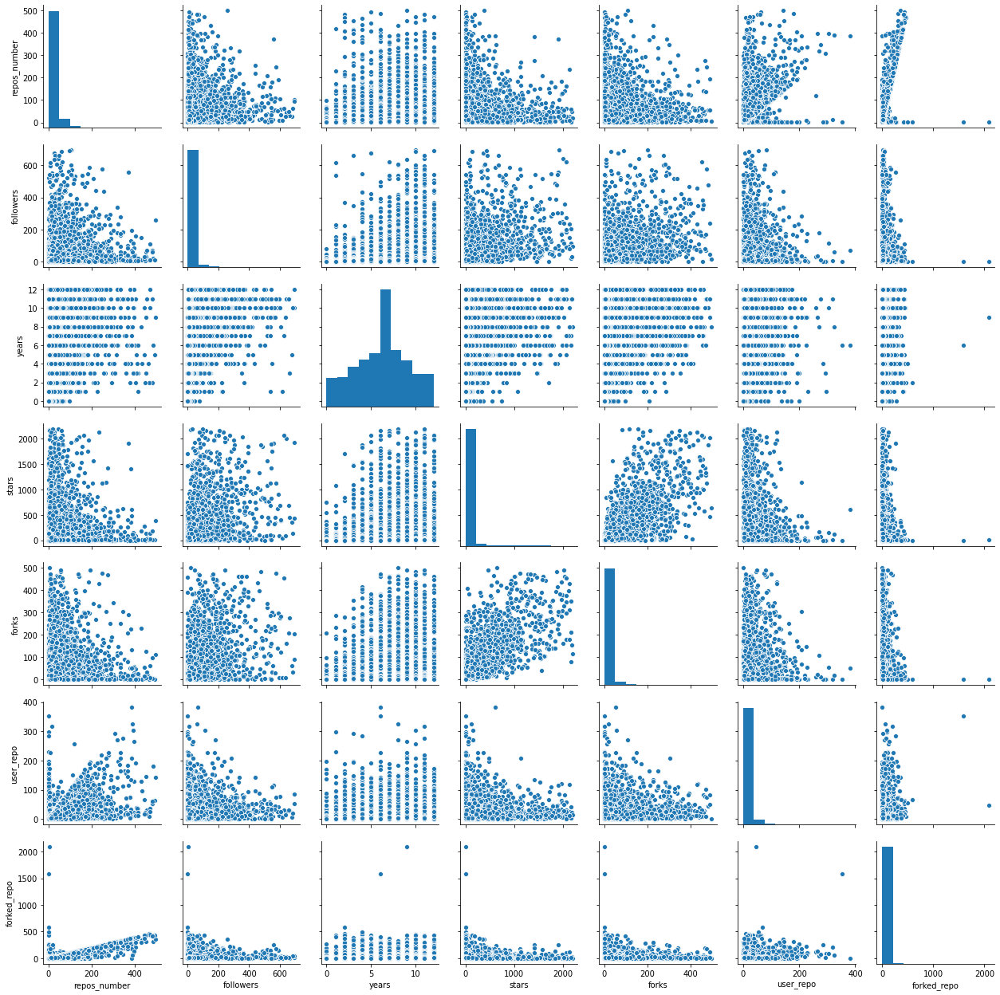

In [43]:
sns.pairplot(df)
plt.show()

#### Now we cannot identify outliers in the pairplot, just in the forked_repo variable, which must be and error, as all of the forked repos should be under 500, which is the max of repos_number, so we we are going to delete these 3 errors too and we will have our sample cleaned

In [44]:
df[df.forked_repo>500]

,name,repos_number,followers,years,stars,forks,user_repo,forked_repo
1514,Alex,1,1,6,0,0,353,1586
6179,Chris James,4,3,9,3,1,46,2092
15756,Jason,1,1,2,0,0,67,587


In [45]:
df.drop(df[df.forked_repo>500].index, inplace=True)

In [46]:
print(df.shape)
df.describe()

(39372, 8)


,repos_number,followers,years,stars,forks,user_repo,forked_repo
count,39372.000000,39372.000000,39372.000000,39372.000000,39372.000000,39372.000000,39372.000000
mean,21.783577,14.792848,6.165041,34.802880,10.673753,11.892004,10.780326
std,32.751624,36.589311,2.890549,137.376106,34.358777,16.664356,24.818296
min,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,5.000000,3.000000,4.000000,0.000000,0.000000,3.000000,1.000000
50%,12.000000,6.000000,6.000000,2.000000,1.000000,7.000000,3.000000
75%,26.000000,12.000000,8.000000,14.000000,6.000000,15.000000,11.000000
max,498.000000,695.000000,12.000000,2194.000000,498.000000,382.000000,491.000000


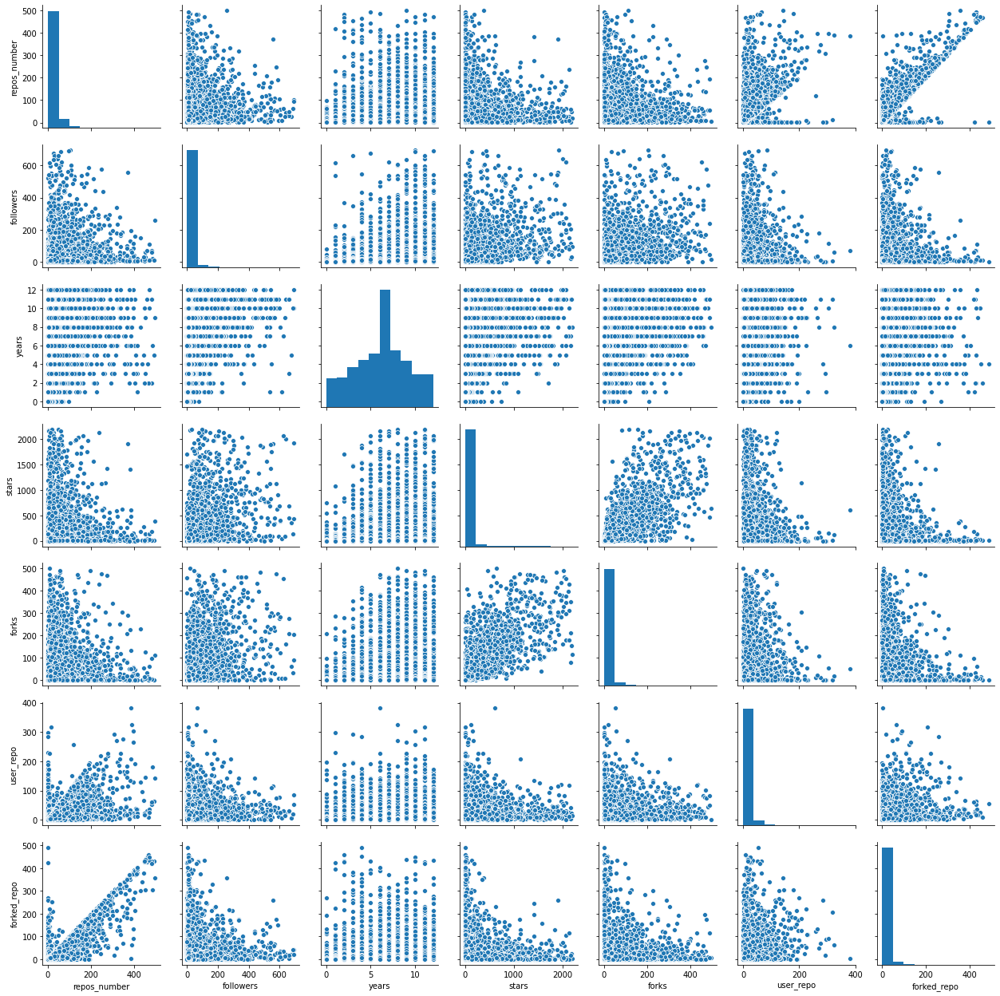

In [47]:
sns.pairplot(df)
plt.show()

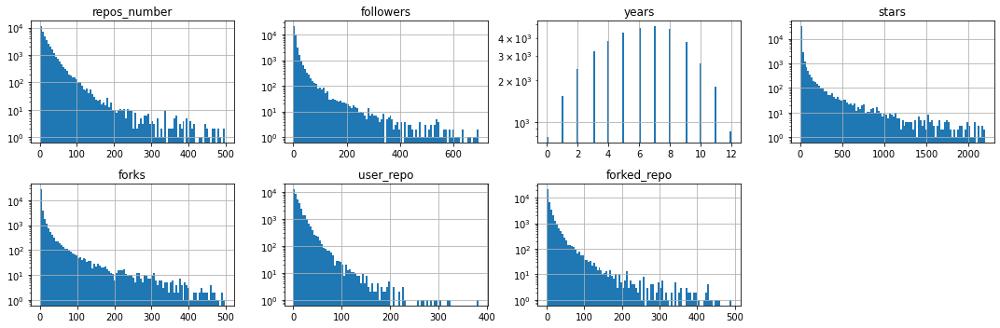

In [48]:
fig = plt.figure(figsize=(15,5))

for n ,c in enumerate(df.iloc[:,1:]):
    ax = fig.add_subplot(2,4,n+1)
    ax.set_title(c)
    ax.set_yscale("log")
    df[c].hist(ax=ax, bins=100)

fig.tight_layout()
plt.show()

#### Finally we have our dataset cleaned, with no visible outliers so we can proceed to apply the dimensional reduction with PCA & t-SNE methods and the cluster with K Means

#### Why this cleaning previous process is so important for clustering? Well, all the 3 algorithms we are going to apply now, select components or clusters, based in distances, each one in a different way. Therefore the distance between dots/users is really important, and the problem of having outliers, is that we could have, at the end, really small clusters and therefore a really bad distribution of our classes, making our clustering not useful

#### Explanation of each algorithm:
    - PCA: https://builtin.com/data-science/step-step-explanation-principal-component-analysis
    - t-SNE: https://www.displayr.com/using-t-sne-to-visualize-data-before-prediction/
    - K Means: https://blog.easysol.net/machine-learning-algorithms-3/#:~:text=Machine%20Learning%20Algorithms%20Explained%20%E2%80%93%20K%2DMeans%20Clustering&text=K%2DMeans%20clustering%20is%20an,to%20similarities%20in%20their%20features.

In [49]:
#we will exclude the id and the repos_number as we will use the user_repo and forked_repo for clustering
name = df.name
repos = df.repos_number
X = df.drop(columns={"name","repos_number"})

### Scale -- Pre PCA

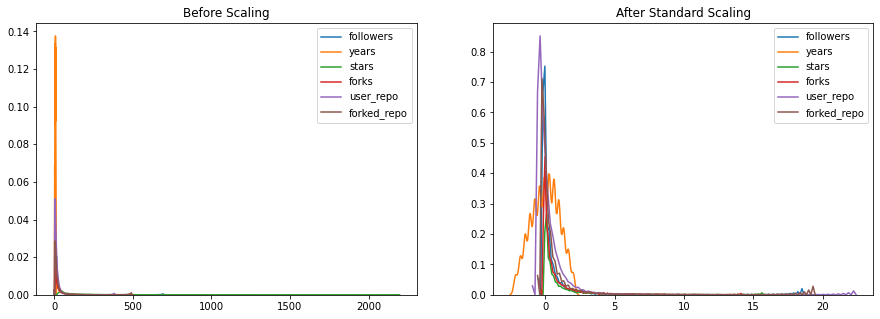

In [50]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()

strans = scaler.fit_transform(X)

X_SS = pd.DataFrame(strans)
X_SS.columns = X.columns

fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(15, 5))
ax1.set_title('Before Scaling')
for e in X.columns:
    sns.kdeplot(X[e], ax=ax1, legend=True)
ax2.set_title('After Standard Scaling')
for e in X_SS.columns:
    sns.kdeplot(X_SS[e], ax=ax2, legend=True)
plt.show()

#### Scaling the data before PCA application is obligatory, the main reason is the algorithm will try to put the maximum variance in the 1st component and so on. So if there is a variable with a variance much higher that the rest, this will affect the algorithm and will bias the component analysis focusing most the attention in that variable

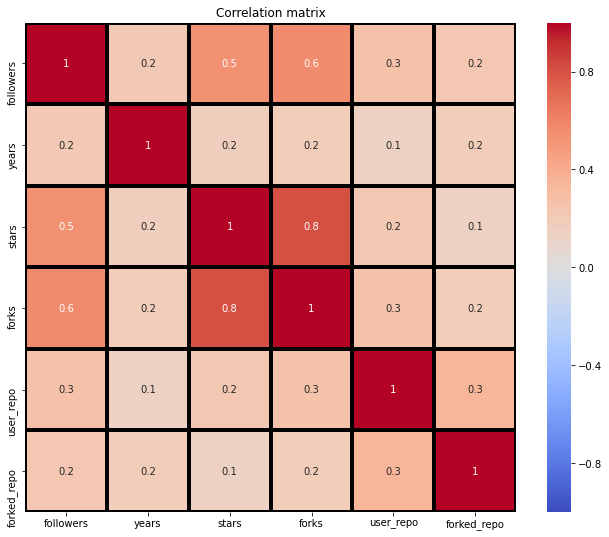

In [51]:
plt.figure(figsize=(11,9))

sns.heatmap(X_SS.corr(), annot = True, fmt='.1g', vmin=-1, vmax=1, center= 0, cmap= 'coolwarm' , linewidths=3, linecolor='black')

plt.title('Correlation matrix')

plt.show()

#### We show it again

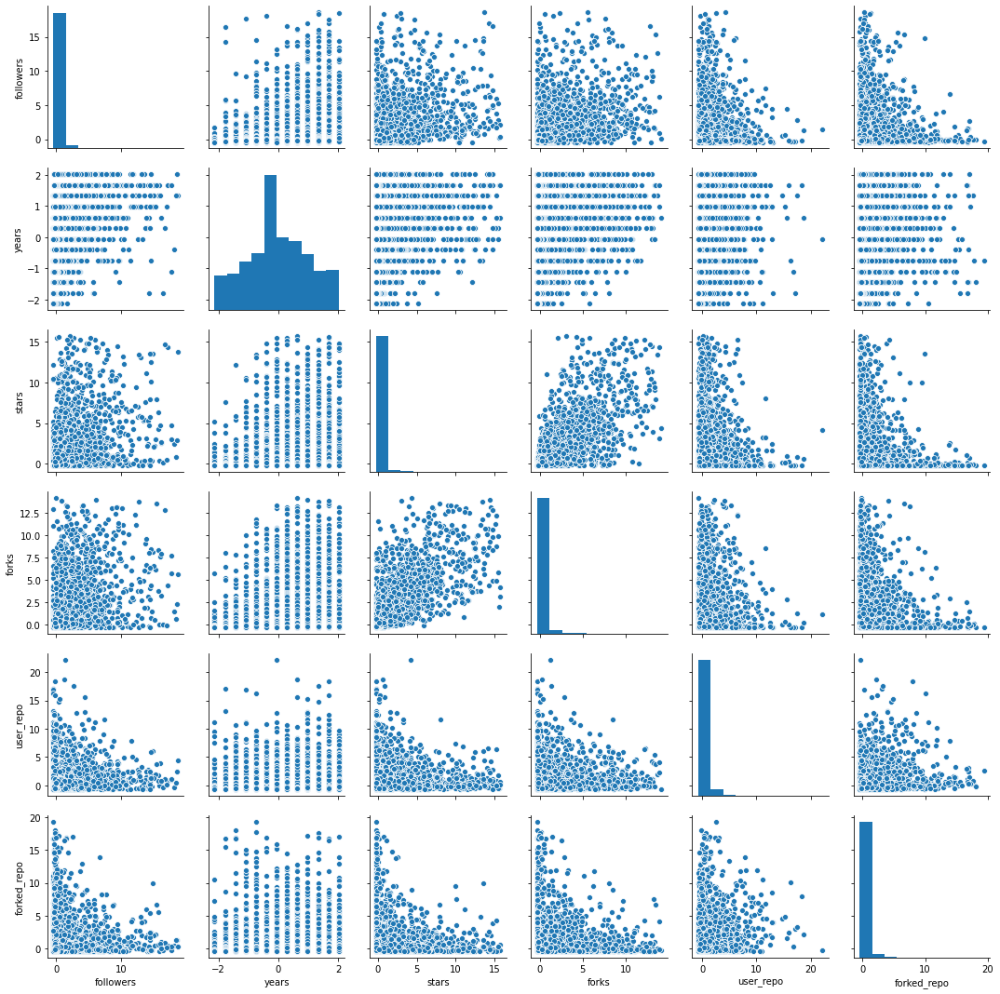

In [52]:
sns.pairplot(X_SS)
plt.show()

#### Before impletementing the dimensionality reduction lets check the dimensions

/home/diego/anaconda3/lib/python3.7/site-packages/seaborn/distributions.py:679: UserWarning:

Passing a 2D dataset for a bivariate plot is deprecated in favor of kdeplot(x, y), and it will cause an error in future versions. Please update your code.



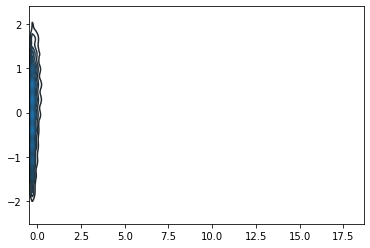

In [53]:
sns.kdeplot(X_SS)
plt.show()

#### Seems to be more than 3 

In [54]:
X_SS.shape

(39372, 6)

#### 6 dimensions actually. This is another way to check the number of dimensions/variables, but we know it since the beginning, as dimensions = variables. Also can bee seen too in the corr matrix or in the pairplot (which is a visual corr matrix)

### PCA -- Choosing number of components

In [55]:
from sklearn.decomposition import PCA

pca = PCA()
pca.fit(X_SS)

PCA(copy=True, iterated_power='auto', n_components=None, random_state=None,
    svd_solver='auto', tol=0.0, whiten=False)

In [56]:
pca.explained_variance_ratio_

array([0.43699019, 0.19358692, 0.14723976, 0.10694685, 0.08427464,
       0.03096164])

Text(0, 0.5, 'Cummulative Explained Variance')

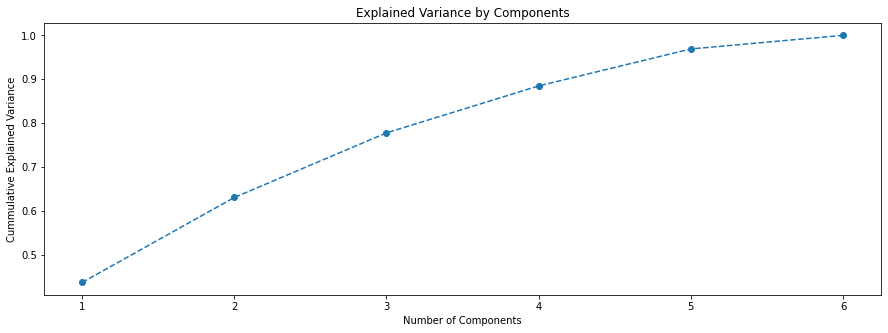

In [57]:
plt.figure(figsize=(15,5)) 
plt.plot(range(1,7), pca.explained_variance_ratio_.cumsum(), marker="o", linestyle="--")
plt.title("Explained Variance by Components")
plt.xlabel("Number of Components")
plt.ylabel("Cummulative Explained Variance")

#### The graph shows the amount of variance captured (on the y-axis) depending on the number of components we include (the x-axis). A rule of thumb is to preserve around 80 % of the variance. So, in this instance, we decide to keep 3 components

In [58]:
pca = PCA(n_components=3).fit(X_SS)
pca_3d = pca.transform(X_SS)

In [59]:
pca_3d.shape

(39372, 3)

In [60]:
pca.components_

array([[ 0.47842226,  0.23536179,  0.51512121,  0.53162114,  0.31242754,
         0.26483034],
       [-0.11207416,  0.31572185, -0.36037826, -0.30543286,  0.5055942 ,
         0.63950909],
       [-0.01543113, -0.90470678,  0.04437494,  0.05391113,  0.36666472,
         0.20481445]])

In [61]:
pca.explained_variance_ratio_

array([0.43699019, 0.19358692, 0.14723976])

### Silhouette Score

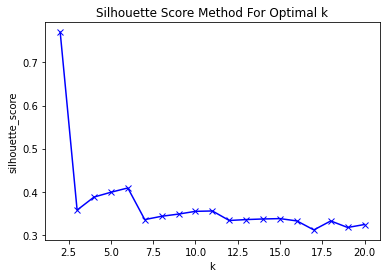

CPU times: user 3 µs, sys: 0 ns, total: 3 µs
Wall time: 5.48 µs


In [62]:
#we use the silhouette method to determine the ideal number of clusters. Although our clusters objective is 4-7
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score

sil = []
kmax = 20
klusters = range(2, kmax+1)
# dissimilarity would not be defined for a single cluster, thus, minimum number of clusters should be 2
for k in klusters:
    km = KMeans(n_clusters = k).fit(pca_3d)
    labels = km.labels_
    sil.append(silhouette_score(pca_3d, labels, metric = 'euclidean'))
    
plt.plot(klusters, sil, 'bx-')
plt.xlabel('k')
plt.ylabel('silhouette_score')
plt.title('Silhouette Score Method For Optimal k')
plt.show()
%time

#### The optimal number of clusters is 2, but we want between 5-7 so we will use 6

In [63]:
model = KMeans(n_clusters=6)

labels_pca = model.fit_predict(pca_3d)

In [64]:
df_pca_kmeans = pd.concat([X, pd.DataFrame(pca_3d).rename(columns={0:"Component1", 1:"Component2", 2:"Component3"}), pd.DataFrame(labels_pca).rename(columns={0:"label"})], axis=1)

df_pca_kmeans.dropna(how="any", inplace=True)
print(df_pca_kmeans.shape)
df_pca_kmeans.head()

(37434, 10)


,followers,years,stars,forks,user_repo,forked_repo,Component1,Component2,Component3,label
0,1.0,6.0,0.0,0.0,2.0,0.0,-0.789941,-0.367506,-0.277139,0.0
1,2.0,3.0,0.0,2.0,18.0,0.0,-0.690220,-0.230586,1.016604,1.0
2,14.0,7.0,7.0,2.0,28.0,15.0,0.166187,0.841124,0.105660,3.0
3,1.0,3.0,0.0,0.0,3.0,13.0,-0.876747,-0.329863,0.791124,1.0
4,3.0,8.0,22.0,6.0,3.0,13.0,-0.268136,0.099094,-0.758157,0.0


### 3D Graphs
I ll do it in matplotlib and interactive in plotly to have both versions

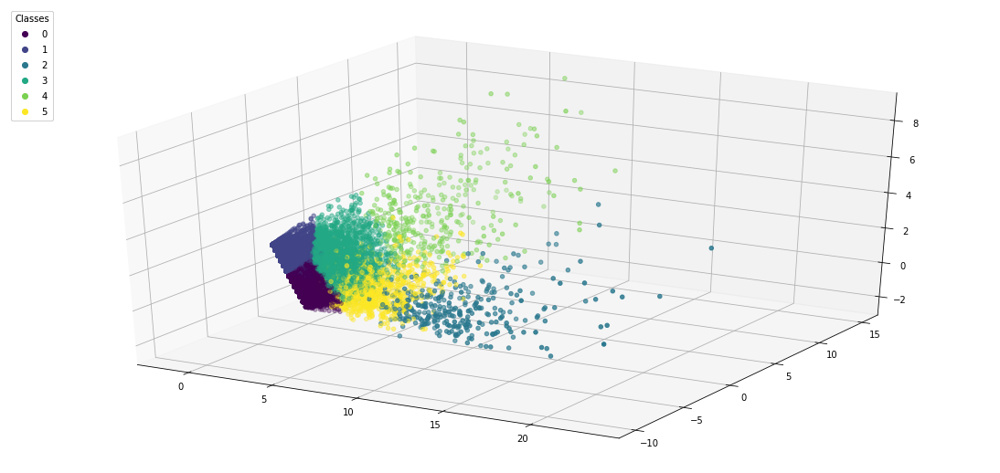

In [65]:
x = df_pca_kmeans.Component1
y = df_pca_kmeans.Component2
z = df_pca_kmeans.Component3

fig = plt.figure(figsize=(15,7))
ax = Axes3D(fig)

scatter = ax.scatter(x, y, z, c=df_pca_kmeans.label)

legend = ax.legend(*scatter.legend_elements(), loc="upper left", title="Classes")

ax.add_artist(legend)
plt.show()

In [66]:
clust_pca = df_pca_kmeans.iloc[:,6:]

In [67]:
cont = []
for i in range(6):
    fig = go.Scatter3d(x=clust_pca.Component1[clust_pca.label==i],
                        y=clust_pca.Component2[clust_pca.label==i],
                        z=clust_pca.Component3[clust_pca.label==i],
                        marker=dict(opacity=0.9,
                                    reversescale=True,
                                    colorscale='Blues',
                                    size=5),
                        line=dict (width=0.02),
                        mode='markers')

    cont.append(fig)    
    
#Make Plot.ly Layout
mylayout = go.Layout(scene=dict(xaxis=dict( title="PCA1"),
                                yaxis=dict( title="PCA2"),
                                zaxis=dict(title="PCA3")),)

#Plot and save html

py.iplot({"data": cont,
                     "layout": mylayout},
                     filename=("3DPlot.html"))

<img src='../OUTPUT/3d.png'/>

In [68]:
lab_pca = df_pca_kmeans.label.value_counts()
lab_pca

0.0    17356
1.0    14266
3.0     3984
5.0     1157
4.0      355
2.0      316
Name: label, dtype: int64

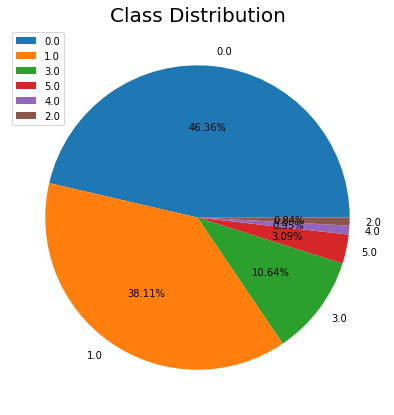

In [69]:
plt.rcParams['figure.figsize'] = (15, 7)
plt.pie(lab_pca, labels = lab_pca.keys(), autopct = '%.2f%%')
plt.title('Class Distribution', fontsize = 20)
plt.axis('off')
plt.legend(loc=2)
plt.show()

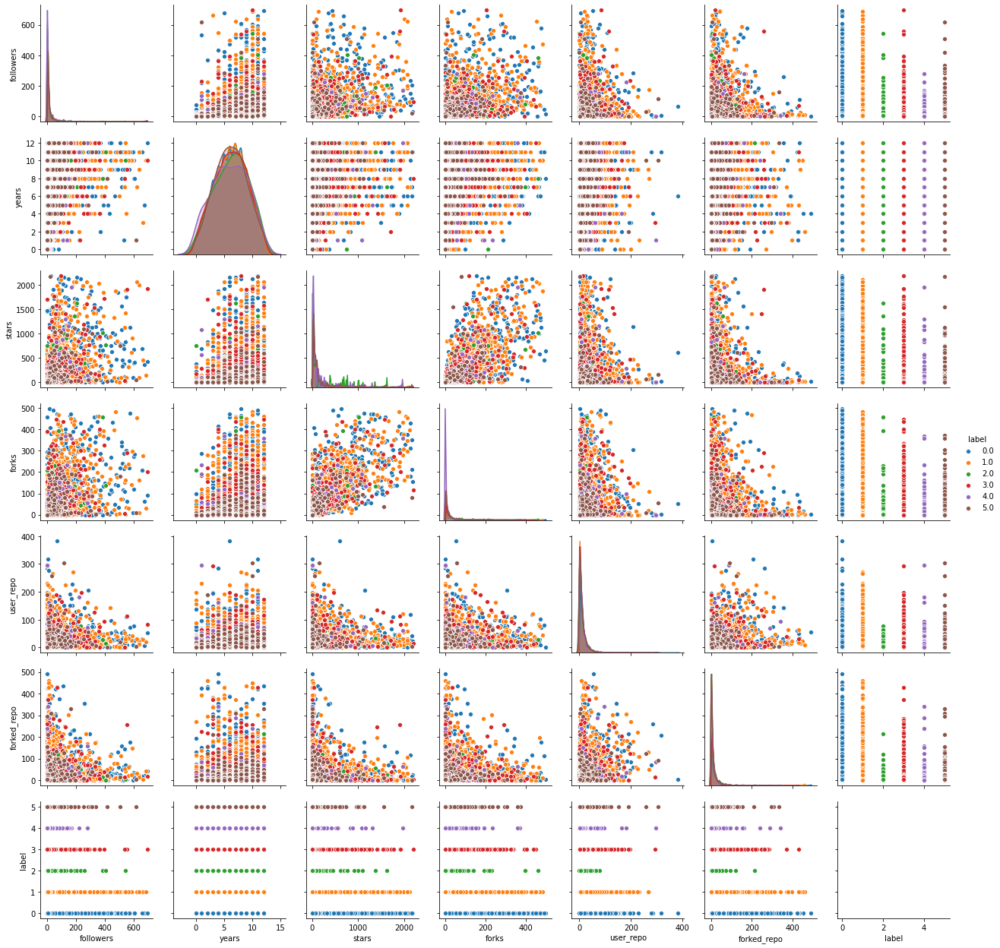

In [70]:
warnings.filterwarnings("ignore")

sns.pairplot(df_pca_kmeans.iloc[:,[0,1,2,3,4,5,9]], hue="label")
plt.show()

### Conlusions from the graph:
- Forked_repos: the label 6 is clearly differentiated from the others
- Stars: label 1 is crearly differentiated and almost all user in the label 5
- Years: labels 0 and 2 are differentiated
- Repos_number: label 3 is differentiated

In [71]:
df_pca_kmeans.describe()

,followers,years,stars,forks,user_repo,forked_repo,Component1,Component2,Component3,label
count,37434.000000,37434.000000,37434.000000,37434.000000,37434.000000,37434.000000,37434.000000,37434.000000,37434.000000,37434.000000
mean,15.103676,6.180237,35.656729,10.926270,11.874579,10.921328,-0.001131,0.003441,0.000298,0.909734
std,37.139261,2.890808,139.454229,34.796525,16.639772,24.844786,1.616142,1.081507,0.941782,1.212254
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-1.318396,-9.897323,-2.287590,0.000000
25%,3.000000,4.000000,0.000000,0.000000,3.000000,1.000000,-0.733502,-0.478074,-0.666641,0.000000
50%,6.000000,6.000000,3.000000,1.000000,7.000000,4.000000,-0.408257,-0.108491,-0.003961,1.000000
75%,13.000000,8.000000,14.000000,6.000000,15.000000,11.000000,0.096479,0.311354,0.659428,1.000000
max,695.000000,12.000000,2194.000000,498.000000,382.000000,491.000000,23.190908,15.039909,8.699766,5.000000


In [72]:
#this allows us to see all the columns
pd.set_option('display.max_columns', None)

df_pca_kmeans.groupby("label").describe()

followers                                                      years  \
          count       mean        std  min  25%  50%   75%    max    count   
label                                                                        
0.0     17356.0  15.067988  37.630225  0.0  3.0  6.0  13.0  693.0  17356.0   
1.0     14266.0  14.979532  36.705669  0.0  3.0  6.0  13.0  685.0  14266.0   
2.0       316.0  21.091772  54.055067  0.0  2.0  6.0  13.0  543.0    316.0   
3.0      3984.0  14.769829  34.445327  0.0  3.0  6.0  13.0  695.0   3984.0   
4.0       355.0  15.785915  30.891725  0.0  3.0  6.0  14.0  281.0    355.0   
5.0      1157.0  16.474503  39.888756  0.0  2.0  6.0  14.0  616.0   1157.0   

                                                       stars             \
           mean       std  min  25%  50%  75%   max    count       mean   
label                                                                     
0.0    6.184432  2.884092  0.0  4.0  6.0  8.0  12.0  17356.0  35.350887   
1.0    6.166199  2.888110  0.0  4.0  6.0  8.0  12.0  14266.0  35.342352   
2.0    6.338608  2.981833  0.0  4.0  7.0  9.0  12.0    316.0  59.598101   
3.0    6.217871  2.917430  0.0  4.0  6.0  8.0  12.0   3984.0  34.750251   
4.0    6.059155  3.142455  0.0  4.0  6.0  8.5  12.0    355.0  46.098592   
5.0    6.154710  2.829239  0.0  4.0  6.0  8.0  12.0   1157.0  37.499568   

                                                  forks                        \
              std  min  25%  50%   75%     max    count       mean        std   
label                                                                           
0.0    139.021476  0.0  0.0  3.0  15.0  2187.0  17356.0  10.956960  35.366829   
1.0    139.120269  0.0  0.0  2.0  13.0  2118.0  14266.0  10.721365  34.207301   
2.0    199.222950  0.0  0.0  2.0  14.0  1627.0    316.0  14.955696  47.194343   
3.0    133.602720  0.0  0.0  2.0  15.0  2194.0   3984.0  10.649598  32.977814   
4.0    173.893821  0.0  0.0  4.0  20.5  1962.0    355.0  13.729577  39.642115   
5.0    137.747931  0.0  0.0  3.0  19.0  2171.0   1157.0  11.984443  33.845411   

                                 user_repo                                  \
       min  25%  50%  75%    max     count       mean        std  min  25%   
label                                                                        
0.0    0.0  0.0  1.0  6.0  498.0   17356.0  11.881251  16.363338  0.0  3.0   
1.0    0.0  0.0  1.0  6.0  483.0   14266.0  11.887004  16.644881  0.0  3.0   
2.0    0.0  0.0  1.0  6.0  459.0     316.0  10.974684  13.643511  0.0  2.0   
3.0    0.0  0.0  1.0  6.0  446.0    3984.0  11.652610  16.447080  0.0  2.0   
4.0    0.0  0.0  1.0  8.5  369.0     355.0  12.988732  24.168778  0.0  2.0   
5.0    0.0  0.0  1.0  8.0  374.0    1157.0  12.289542  19.094602  0.0  3.0   

                        forked_repo                                       \
       50%   75%    max       count       mean        std  min  25%  50%   
label                                                                      
0.0    7.0  15.0  382.0     17356.0  11.039640  25.078981  0.0  1.0  4.0   
1.0    7.0  15.0  271.0     14266.0  10.852867  24.907763  0.0  1.0  3.0   
2.0    6.0  15.0   77.0       316.0  10.094937  19.226400  0.0  1.0  4.0   
3.0    6.5  15.0  293.0      3984.0  10.475151  23.382086  0.0  1.0  3.0   
4.0    7.0  14.0  297.0       355.0  12.757746  32.235590  0.0  1.0  4.0   
5.0    7.0  15.0  304.0      1157.0  11.189283  24.183153  0.0  1.0  4.0   

                   Component1                                           \
        75%    max      count       mean       std       min       25%   
label                                                                    
0.0    11.0  491.0    17356.0  -0.199649  0.449307 -0.829842 -0.514184   
1.0    11.0  460.0    14266.0  -0.744099  0.374506 -1.318396 -0.986050   
2.0    11.0  215.0      316.0  11.579525  3.053197  6.617115  9.147551   
3.0    11.0  428.0     3984.0   0.997079  0.764076 -0.244759  0.4

In [73]:
df_pca_kmeans = df_pca_kmeans.reset_index().drop(columns={"index"})
df_pca_kmeans_grouped = df_pca_kmeans.groupby("label").agg({"followers":"mean", "years":"mean", "stars":"mean", "forks":"mean", "user_repo":"mean", "forked_repo":"mean"}).reset_index()
df_pca_kmeans_grouped

,label,followers,years,stars,forks,user_repo,forked_repo
0,0.0,15.067988,6.184432,35.350887,10.956960,11.881251,11.039640
1,1.0,14.979532,6.166199,35.342352,10.721365,11.887004,10.852867
2,2.0,21.091772,6.338608,59.598101,14.955696,10.974684,10.094937
3,3.0,14.769829,6.217871,34.750251,10.649598,11.652610,10.475151
4,4.0,15.785915,6.059155,46.098592,13.729577,12.988732,12.757746
5,5.0,16.474503,6.154710,37.499568,11.984443,12.289542,11.189283


In [74]:
categories = list(df_pca_kmeans_grouped)[1:]

fig = go.Figure()

for v in df_pca_kmeans_grouped.values:
    fig.add_trace(go.Scatterpolar(
    r=v[1:],
    theta=categories,
    fill="toself",
    name=str(v[0]),
    text=str(v[0]),
    opacity=1,
    marker=dict(size=10)
    ))
    
fig.update_layout(polar=dict(radialaxis=dict(visible=True, range=[0, 60])), showlegend=True)

fig.show()

<img src='../OUTPUT/radar.png'/>

#### This chart allows us to see the characteristics of each class based in the initial variables, but in a scaled way. Therefore it allows us to identificate clearly 7 type of users

In [75]:
X_pca_kmeans = df_pca_kmeans.iloc[:,:6]
X_pca_kmeans.head()

,followers,years,stars,forks,user_repo,forked_repo
0,1.0,6.0,0.0,0.0,2.0,0.0
1,2.0,3.0,0.0,2.0,18.0,0.0
2,14.0,7.0,7.0,2.0,28.0,15.0
3,1.0,3.0,0.0,0.0,3.0,13.0
4,3.0,8.0,22.0,6.0,3.0,13.0


In [76]:
strans = scaler.fit_transform(X_pca_kmeans)

X_pca_kmeans_scaled = pd.DataFrame(strans)
X_pca_kmeans_scaled.columns = X_pca_kmeans.columns
X_pca_kmeans_scaled["label"] = df_pca_kmeans.label

In [79]:
df_pca_kmeans_scaled = X_pca_kmeans_scaled.groupby("label").agg({"followers":"mean", "years":"mean", "stars":"mean", "forks":"mean", "user_repo":"mean", "forked_repo":"mean"}).reset_index()
df_pca_kmeans_scaled

,label,followers,years,stars,forks,user_repo,forked_repo
0,0.0,-0.000961,0.001451,-0.002193,0.000882,0.000401,0.004762
1,1.0,-0.003343,-0.004856,-0.002254,-0.005889,0.000747,-0.002756
2,2.0,0.161236,0.054785,0.171681,0.115801,-0.054082,-0.033263
3,3.0,-0.008989,0.013019,-0.006500,-0.007951,-0.013340,-0.017959
4,4.0,0.018370,-0.041886,0.074878,0.080564,0.066958,0.073917
5,5.0,0.036911,-0.008830,0.013215,0.030411,0.024938,0.010785


In [81]:
categories = list(df_pca_kmeans_scaled)[1:]

fig = go.Figure()

for v in df_pca_kmeans_scaled.values:
    fig.add_trace(go.Scatterpolar(
    r=v[1:],
    theta=categories,
    fill="toself",
    name=str(v[0]),
    text=str(v[0]),
    opacity=1,
    marker=dict(size=10)
    ))
    
fig.update_layout(polar=dict(radialaxis=dict(visible=True, range=[-.2, .2])), showlegend=True)

fig.show()

#### As said before, this notebook is useful to see the application of PCA and K Means in a dataset with the purpose of finding clusters. However for a real utility, the outliers must be excluded to have well distributed clusters. Therefore I will do a similar notebook without outliers

### t-SNE

In [82]:
from sklearn.manifold import TSNE

tsne = TSNE(n_components=3, perplexity=50)

tsne_3d = tsne.fit_transform(X)

In [83]:
tsne_3d.shape

(39372, 3)

### Silhouette Score

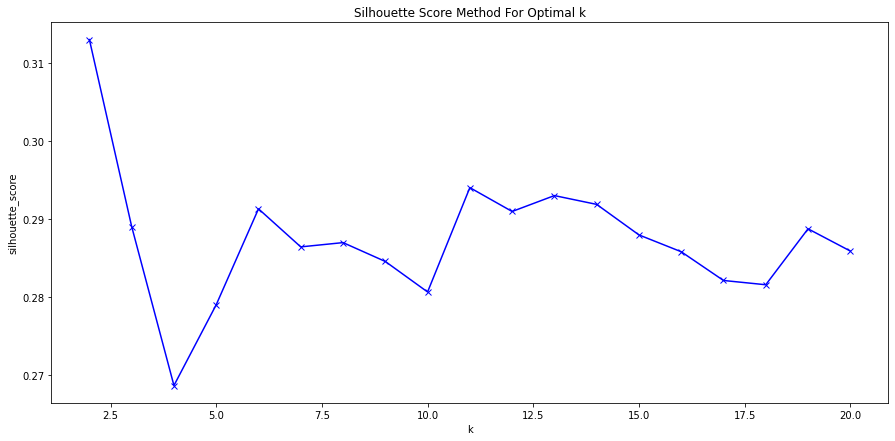

CPU times: user 3 µs, sys: 0 ns, total: 3 µs
Wall time: 5.72 µs


In [84]:
#we use the silhouette method to determine the ideal number of clusters. Although our clusters objective is 4-7
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score

sil = []
kmax = 20
klusters = range(2, kmax+1)
# dissimilarity would not be defined for a single cluster, thus, minimum number of clusters should be 2
for k in klusters:
    km = KMeans(n_clusters = k).fit(tsne_3d)
    labels = km.labels_
    sil.append(silhouette_score(tsne_3d, labels, metric = 'euclidean'))
    
plt.plot(klusters, sil, 'bx-')
plt.xlabel('k')
plt.ylabel('silhouette_score')
plt.title('Silhouette Score Method For Optimal k')
plt.show()
%time

#### The optimal number of clusters is 2, but we want between 5-7 so we will use 6

In [85]:
model = KMeans(n_clusters=6)

labels_tsne = model.fit_predict(tsne_3d)

In [86]:
df_tsne_kmeans = pd.concat([df.iloc[:,2:9], pd.DataFrame(tsne_3d).rename(columns={0:"Component1", 1:"Component2", 2:"Component3"}), pd.DataFrame(labels_tsne).rename(columns={0:"label"})], axis=1)

df_tsne_kmeans.dropna(how="any", inplace=True)
print(df_tsne_kmeans.shape)
df_tsne_kmeans.head()

(37434, 10)


,followers,years,stars,forks,user_repo,forked_repo,Component1,Component2,Component3,label
0,1.0,6.0,0.0,0.0,2.0,0.0,-3.240307,14.209631,-15.294332,5.0
1,2.0,3.0,0.0,2.0,18.0,0.0,14.022371,-12.714595,-0.095859,3.0
2,14.0,7.0,7.0,2.0,28.0,15.0,4.315002,-9.833199,10.680215,2.0
3,1.0,3.0,0.0,0.0,3.0,13.0,-8.137653,-17.101639,-0.733167,0.0
4,3.0,8.0,22.0,6.0,3.0,13.0,-0.704015,-1.940890,6.752790,2.0


### 3D Graphs
I ll do it in matplotlib and interactive in plotly to have both versions

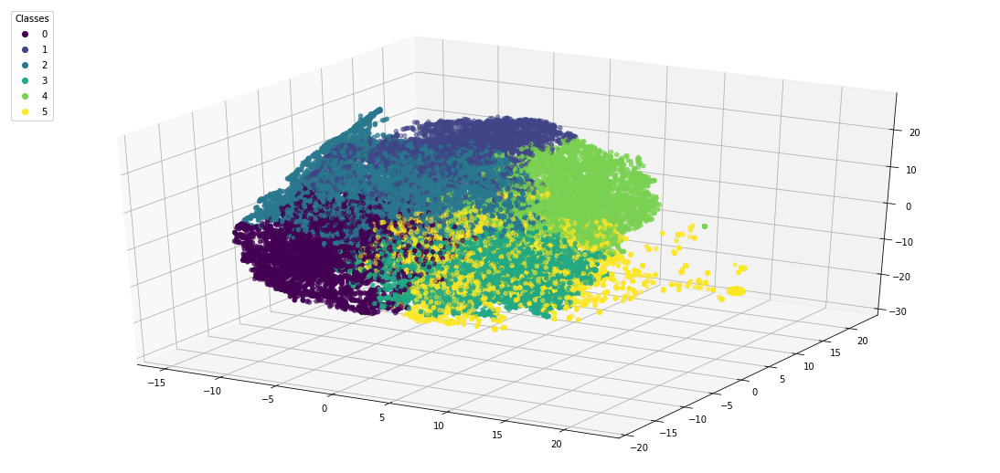

In [87]:
x = df_tsne_kmeans.Component1
y = df_tsne_kmeans.Component2
z = df_tsne_kmeans.Component3

fig = plt.figure(figsize=(15,7))
ax = Axes3D(fig)

scatter = ax.scatter(x, y, z, c=df_tsne_kmeans.label)

legend = ax.legend(*scatter.legend_elements(), loc="upper left", title="Classes")

ax.add_artist(legend)
plt.show()

In [88]:
clust_tsne = df_tsne_kmeans.iloc[:,6:]

In [89]:
cont = []
for i in range(6):
    fig = go.Scatter3d(x=clust_tsne.Component1[clust_tsne.label==i],
                        y=clust_tsne.Component2[clust_tsne.label==i],
                        z=clust_tsne.Component3[clust_tsne.label==i],
                        marker=dict(opacity=0.9,
                                    reversescale=True,
                                    colorscale='Blues',
                                    size=5),
                        line=dict (width=0.02),
                        mode='markers')

    cont.append(fig)    
    
#Make Plot.ly Layout
mylayout = go.Layout(scene=dict(xaxis=dict( title="PCA1"),
                                yaxis=dict( title="PCA2"),
                                zaxis=dict(title="PCA3")),)

#Plot and save html

py.iplot({"data": cont,
                     "layout": mylayout},
                     filename=("3DPlot.html"))

<img src='../OUTPUT/3d.png'/>

In [90]:
lab_tsne = df_tsne_kmeans.label.value_counts()
lab_tsne

5.0    8497
2.0    6640
0.0    6394
3.0    6012
4.0    5078
1.0    4813
Name: label, dtype: int64

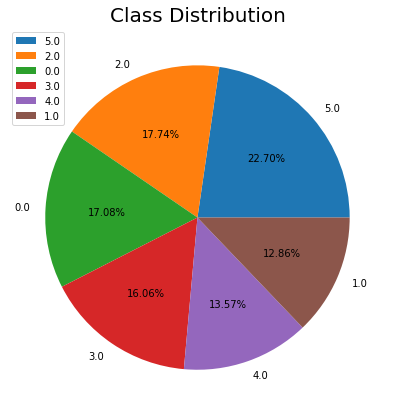

In [91]:
plt.rcParams['figure.figsize'] = (15, 7)
plt.pie(lab_tsne, labels = lab_tsne.keys(), autopct = '%.2f%%')
plt.title('Class Distribution', fontsize = 20)
plt.axis('off')
plt.legend(loc=2)
plt.show()

#### We can clearly see the 7 classes in the 3D graphs, however the distribution of the classes is really unfair to obtain clearly programmers by seniority. However we are going to see how each class is identified in each variable

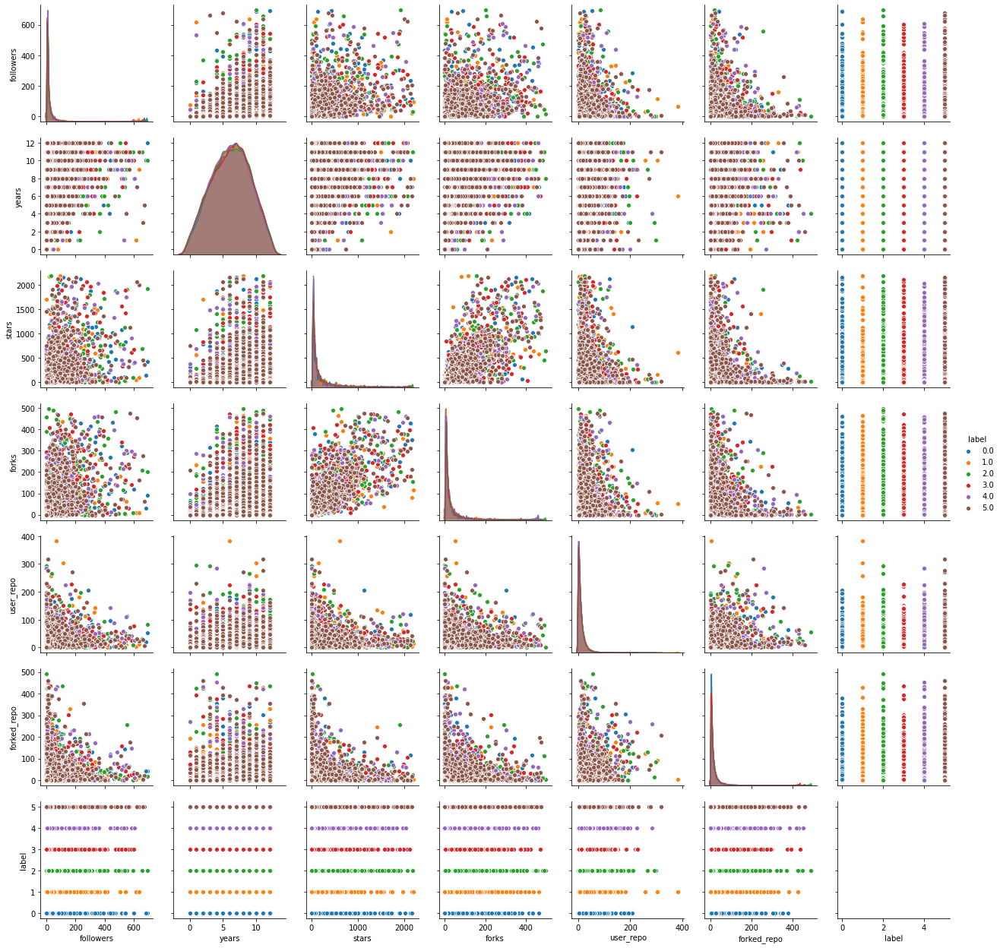

In [92]:
warnings.filterwarnings("ignore")

sns.pairplot(df_tsne_kmeans.iloc[:,[0,1,2,3,4,5,9]], hue="label")
plt.show()

### Conlusions from the graph:
- Forked_repos: the label 6 is clearly differentiated from the others
- Stars: label 1 is crearly differentiated and almost all user in the label 5
- Years: labels 0 and 2 are differentiated
- Repos_number: label 3 is differentiated

In [93]:
df_tsne_kmeans.describe()

,followers,years,stars,forks,user_repo,forked_repo,Component1,Component2,Component3,label
count,37434.000000,37434.000000,37434.000000,37434.000000,37434.000000,37434.000000,37434.000000,37434.000000,37434.000000,37434.000000
mean,15.103676,6.180237,35.656729,10.926270,11.874579,10.921328,-0.031276,-0.099110,0.160133,2.642678
std,37.139261,2.890808,139.454229,34.796525,16.639772,24.844786,7.571228,9.099136,11.573400,1.773397
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-14.829350,-18.123491,-27.857080,0.000000
25%,3.000000,4.000000,0.000000,0.000000,3.000000,1.000000,-6.489801,-7.676684,-9.114177,1.000000
50%,6.000000,6.000000,3.000000,1.000000,7.000000,4.000000,-0.369511,-0.303910,0.270081,3.000000
75%,13.000000,8.000000,14.000000,6.000000,15.000000,11.000000,6.235901,6.881217,9.654071,4.000000
max,695.000000,12.000000,2194.000000,498.000000,382.000000,491.000000,21.913254,22.494207,25.868275,5.000000


In [94]:
#this allows us to see all the columns
pd.set_option('display.max_columns', None)

df_tsne_kmeans.groupby("label").describe()

followers                                                     years  \
          count       mean        std  min  25%  50%   75%    max   count   
label                                                                       
0.0      6394.0  15.064435  37.523458  0.0  3.0  6.0  13.0  693.0  6394.0   
1.0      4813.0  14.990858  34.739224  0.0  3.0  6.0  13.0  637.0  4813.0   
2.0      6640.0  15.513404  39.049682  0.0  3.0  6.0  13.0  695.0  6640.0   
3.0      6012.0  15.132568  37.478435  0.0  3.0  6.0  13.0  601.0  6012.0   
4.0      5078.0  14.533478  35.330851  0.0  3.0  6.0  13.0  606.0  5078.0   
5.0      8497.0  15.197246  37.451122  0.0  3.0  6.0  13.0  675.0  8497.0   

                                                      stars             \
           mean       std  min  25%  50%  75%   max   count       mean   
label                                                                    
0.0    6.236628  2.871811  0.0  4.0  6.0  8.0  12.0  6394.0  36.435408   
1.0    6.145024  2.887715  0.0  4.0  6.0  8.0  12.0  4813.0  35.100977   
2.0    6.217922  2.891617  0.0  4.0  6.0  8.0  12.0  6640.0  35.392319   
3.0    6.203593  2.904365  0.0  4.0  6.0  8.0  12.0  6012.0  34.951763   
4.0    6.085467  2.862515  0.0  4.0  6.0  8.0  12.0  5078.0  33.051792   
5.0    6.168412  2.912406  0.0  4.0  6.0  8.0  12.0  8497.0  37.647758   

                                                 forks                        \
              std  min  25%  50%   75%     max   count       mean        std   
label                                                                          
0.0    139.927065  0.0  0.0  3.0  15.0  2159.0  6394.0  11.109165  34.421786   
1.0    132.297271  0.0  0.0  2.0  15.0  2194.0  4813.0  10.765011  32.662043   
2.0    136.939871  0.0  0.0  3.0  15.0  2187.0  6640.0  11.014458  35.581526   
3.0    141.850588  0.0  0.0  2.0  13.0  2118.0  6012.0  10.926647  35.492656   
4.0    131.156237  0.0  0.0  2.0  14.0  2029.0  5078.0  10.373966  33.316121   
5.0    147.851353  0.0  0.0  3.0  13.0  2157.0  8497.0  11.140873  35.982966   

                                 user_repo                                  \
       min  25%  50%  75%    max     count       mean        std  min  25%   
label                                                                        
0.0    0.0  0.0  1.0  6.0  462.0    6394.0  11.830466  15.724777  0.0  2.0   
1.0    0.0  0.0  1.0  7.0  465.0    4813.0  11.507999  16.970409  0.0  2.0   
2.0    0.0  0.0  1.0  6.0  498.0    6640.0  11.860542  16.993601  0.0  3.0   
3.0    0.0  0.0  1.0  6.0  471.0    6012.0  12.236028  16.820275  0.0  3.0   
4.0    0.0  0.0  1.0  6.0  461.0    5078.0  11.990351  16.804924  0.0  3.0   
5.0    0.0  0.0  1.0  6.0  475.0    8497.0  11.801459  16.612568  0.0  3.0   

                        forked_repo                                       \
       50%   75%    max       count       mean        std  min  25%  50%   
label                                                                      
0.0    7.0  15.0  207.0      6394.0  10.775102  23.971464  0.0  1.0  4.0   
1.0    7.0  14.0  382.0      4813.0  10.772699  23.101233  0.0  1.0  4.0   
2.0    7.0  15.0  297.0      6640.0  10.948343  25.239994  0.0  1.0  4.0   
3.0    7.0  15.0  227.0      6012.0  11.117598  24.185153  0.0  1.0  4.0   
4.0    7.0  15.0  284.0      5078.0  10.938558  26.579335  0.0  1.0  3.0   
5.0    7.0  15.0  318.0      8497.0  10.945275  25.516841  0.0  1.0  4.0   

                    Component1                                            \
         75%    max      count      mean       std        min        25%   
label                                                                      
0.0    11.00  379.0     6394.0 -7.309813  3.670427 -14.829350 -10.208394   
1.0    11.00  428.0     4813.0 -6.704064  4.101164 -14.197823 -10.015685   
2.0    11.00  491.0     6640.0 -1.511694  5.864450 -13.060478  -6.460353   
3.0    11.00  437.0     6012.0  7.269066  4.138968  -2.533736   3.701921   
4.0 

In [95]:
df_tsne_kmeans = df_tsne_kmeans.reset_index().drop(columns={"index"})
df_tsne_kmeans_grouped = df_tsne_kmeans.groupby("label").agg({"followers":"mean", "years":"mean", "stars":"mean", "forks":"mean", "user_repo":"mean", "forked_repo":"mean"}).reset_index()
df_tsne_kmeans_grouped

,label,followers,years,stars,forks,user_repo,forked_repo
0,0.0,15.064435,6.236628,36.435408,11.109165,11.830466,10.775102
1,1.0,14.990858,6.145024,35.100977,10.765011,11.507999,10.772699
2,2.0,15.513404,6.217922,35.392319,11.014458,11.860542,10.948343
3,3.0,15.132568,6.203593,34.951763,10.926647,12.236028,11.117598
4,4.0,14.533478,6.085467,33.051792,10.373966,11.990351,10.938558
5,5.0,15.197246,6.168412,37.647758,11.140873,11.801459,10.945275


In [104]:
categories = list(df_tsne_kmeans_grouped)[1:]

fig = go.Figure()

for v in df_tsne_kmeans_grouped.values:
    fig.add_trace(go.Scatterpolar(
    r=v[1:],
    theta=categories,
    fill="toself",
    name=str(v[0]),
    text=str(v[0]),
    opacity=1,
    marker=dict(size=10)
    ))
    
fig.update_layout(polar=dict(radialaxis=dict(visible=True, range=[0, 40])), showlegend=True)

fig.show()

<img src='../OUTPUT/radar.png'/>

In [97]:
X_tsne_kmeans = df_tsne_kmeans.iloc[:,:6]
X_tsne_kmeans.head()

,followers,years,stars,forks,user_repo,forked_repo
0,1.0,6.0,0.0,0.0,2.0,0.0
1,2.0,3.0,0.0,2.0,18.0,0.0
2,14.0,7.0,7.0,2.0,28.0,15.0
3,1.0,3.0,0.0,0.0,3.0,13.0
4,3.0,8.0,22.0,6.0,3.0,13.0


In [98]:
strans = scaler.fit_transform(X_tsne_kmeans)

X_tsne_kmeans_scaled = pd.DataFrame(strans)
X_tsne_kmeans_scaled.columns = X_tsne_kmeans.columns
X_tsne_kmeans_scaled["label"] = df_tsne_kmeans.label

In [101]:
df_tsne_kmeans_scaled = X_tsne_kmeans_scaled.groupby("label").agg({"followers":"mean", "years":"mean", "stars":"mean", "forks":"mean", "user_repo":"mean", "forked_repo":"mean"}).reset_index()
df_tsne_kmeans_scaled

,label,followers,years,stars,forks,user_repo,forked_repo
0,0.0,-0.001057,0.019507,0.005584,0.005256,-0.002651,-0.005886
1,1.0,-0.003038,-0.012181,-0.003985,-0.004634,-0.022031,-0.005982
2,2.0,0.011032,0.013036,-0.001896,0.002534,-0.000844,0.001087
3,3.0,0.000778,0.008079,-0.005055,0.000011,0.021722,0.007900
4,4.0,-0.015353,-0.032784,-0.018680,-0.015873,0.006958,0.000694
5,5.0,0.002519,-0.004091,0.014277,0.006167,-0.004394,0.000964


In [103]:
categories = list(df_tsne_kmeans_scaled)[1:]

fig = go.Figure()

for v in df_tsne_kmeans_scaled.values:
    fig.add_trace(go.Scatterpolar(
    r=v[1:],
    theta=categories,
    fill="toself",
    name=str(v[0]),
    text=str(v[0]),
    opacity=1,
    marker=dict(size=10)
    ))
    
fig.update_layout(polar=dict(radialaxis=dict(visible=True, range=[-.04, .03])), showlegend=True)

fig.show()

#### As said before, this notebook is useful to see the application of PCA and K Means in a dataset with the purpose of finding clusters. However for a real utility, the outliers must be excluded to have well distributed clusters. Therefore I will do a similar notebook without outliers